In [3]:
#import libraries 
import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

In [4]:
data=pd.read_csv('loan-train.csv')
data

,Loan_ID,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,LP001002,Male,No,0,Graduate,No,5849,0.0,NaN,360.0,1.0,Urban,Y
1,LP001003,Male,Yes,1,Graduate,No,4583,1508.0,128.0,360.0,1.0,Rural,N
2,LP001005,Male,Yes,0,Graduate,Yes,3000,0.0,66.0,360.0,1.0,Urban,Y
3,LP001006,Male,Yes,0,Not Graduate,No,2583,2358.0,120.0,360.0,1.0,Urban,Y
4,LP001008,Male,No,0,Graduate,No,6000,0.0,141.0,360.0,1.0,Urban,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...
609,LP002978,Female,No,0,Graduate,No,2900,0.0,71.0,360.0,1.0,Rural,Y
610,LP002979,Male,Yes,3+,Graduate,No,4106,0.0,40.0,180.0,1.0,Rural,Y
611,LP002983,Male,Yes,1,Graduate,No,8072,240.0,253.0,360.0,1.0,Urban,Y
612,LP002984,Male,Yes,2,Graduate,No,7583,0.0,187.0,360.0,1.0,Urban,Y


In [5]:
#explore the entire data---> info()
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 614 entries, 0 to 613
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Loan_ID            614 non-null    object 
 1   Gender             601 non-null    object 
 2   Married            611 non-null    object 
 3   Dependents         599 non-null    object 
 4   Education          614 non-null    object 
 5   Self_Employed      582 non-null    object 
 6   ApplicantIncome    614 non-null    int64  
 7   CoapplicantIncome  614 non-null    float64
 8   LoanAmount         592 non-null    float64
 9   Loan_Amount_Term   600 non-null    float64
 10  Credit_History     564 non-null    float64
 11  Property_Area      614 non-null    object 
 12  Loan_Status        614 non-null    object 
dtypes: float64(4), int64(1), object(8)
memory usage: 62.5+ KB


In [6]:
data.isnull().sum()

Loan_ID               0
Gender               13
Married               3
Dependents           15
Education             0
Self_Employed        32
ApplicantIncome       0
CoapplicantIncome     0
LoanAmount           22
Loan_Amount_Term     14
Credit_History       50
Property_Area         0
Loan_Status           0
dtype: int64

In [7]:
data['Dependents'].value_counts()

Dependents
0     345
1     102
2     101
3+     51
Name: count, dtype: int64

In [8]:
data['Self_Employed'].value_counts()

Self_Employed
No     500
Yes     82
Name: count, dtype: int64

In [9]:
data['Credit_History'].value_counts()

Credit_History
1.0    475
0.0     89
Name: count, dtype: int64

In [10]:
data['Credit_History']= data['Credit_History'].astype('object')
data['Credit_History']

0      1.0
1      1.0
2      1.0
3      1.0
4      1.0
      ... 
609    1.0
610    1.0
611    1.0
612    1.0
613    0.0
Name: Credit_History, Length: 614, dtype: object

In [11]:
data.drop(columns=['Loan_ID'],inplace=True)

In [12]:
#data['Gender'].value_counts()
data['Gender'].mode()[0]

'Male'

In [13]:
#we will the missing values from object columns and other dtype columns
data.columns
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 614 entries, 0 to 613
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Gender             601 non-null    object 
 1   Married            611 non-null    object 
 2   Dependents         599 non-null    object 
 3   Education          614 non-null    object 
 4   Self_Employed      582 non-null    object 
 5   ApplicantIncome    614 non-null    int64  
 6   CoapplicantIncome  614 non-null    float64
 7   LoanAmount         592 non-null    float64
 8   Loan_Amount_Term   600 non-null    float64
 9   Credit_History     564 non-null    object 
 10  Property_Area      614 non-null    object 
 11  Loan_Status        614 non-null    object 
dtypes: float64(3), int64(1), object(8)
memory usage: 57.7+ KB


In [14]:
data.columns

Index(['Gender', 'Married', 'Dependents', 'Education', 'Self_Employed',
       'ApplicantIncome', 'CoapplicantIncome', 'LoanAmount',
       'Loan_Amount_Term', 'Credit_History', 'Property_Area', 'Loan_Status'],
      dtype='object')

In [15]:
#we will iterate with each column for object coiumn will fill with mode else fill with mean
for col in data.columns:
    if data[col].dtype == "object":
        #print(data[col])
        data[col]= data[col].fillna(data[col].mode()[0])
    else:
        data[col]= data[col].fillna(data[col].mean())

In [16]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 614 entries, 0 to 613
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Gender             614 non-null    object 
 1   Married            614 non-null    object 
 2   Dependents         614 non-null    object 
 3   Education          614 non-null    object 
 4   Self_Employed      614 non-null    object 
 5   ApplicantIncome    614 non-null    int64  
 6   CoapplicantIncome  614 non-null    float64
 7   LoanAmount         614 non-null    float64
 8   Loan_Amount_Term   614 non-null    float64
 9   Credit_History     614 non-null    float64
 10  Property_Area      614 non-null    object 
 11  Loan_Status        614 non-null    object 
dtypes: float64(4), int64(1), object(7)
memory usage: 57.7+ KB


In [17]:
from sklearn.preprocessing import LabelEncoder

In [18]:
encoder=LabelEncoder()

In [19]:
data['Credit_History']= data['Credit_History'].astype('object')
data['Credit_History']

0      1.0
1      1.0
2      1.0
3      1.0
4      1.0
      ... 
609    1.0
610    1.0
611    1.0
612    1.0
613    0.0
Name: Credit_History, Length: 614, dtype: object

In [20]:
for col in data.columns:
    if data[col].dtype == "object":
        data[col] = encoder.fit_transform(data[col])
        label_dict= dict(zip(encoder.transform(encoder.classes_),
                         encoder.classes_))
        print(label_dict)
        print('------------------------------------')

{0: 'Female', 1: 'Male'}
------------------------------------
{0: 'No', 1: 'Yes'}
------------------------------------
{0: '0', 1: '1', 2: '2', 3: '3+'}
------------------------------------
{0: 'Graduate', 1: 'Not Graduate'}
------------------------------------
{0: 'No', 1: 'Yes'}
------------------------------------
{0: 0.0, 1: 1.0}
------------------------------------
{0: 'Rural', 1: 'Semiurban', 2: 'Urban'}
------------------------------------
{0: 'N', 1: 'Y'}
------------------------------------


In [21]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 614 entries, 0 to 613
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Gender             614 non-null    int32  
 1   Married            614 non-null    int32  
 2   Dependents         614 non-null    int32  
 3   Education          614 non-null    int32  
 4   Self_Employed      614 non-null    int32  
 5   ApplicantIncome    614 non-null    int64  
 6   CoapplicantIncome  614 non-null    float64
 7   LoanAmount         614 non-null    float64
 8   Loan_Amount_Term   614 non-null    float64
 9   Credit_History     614 non-null    int32  
 10  Property_Area      614 non-null    int32  
 11  Loan_Status        614 non-null    int32  
dtypes: float64(3), int32(8), int64(1)
memory usage: 38.5 KB


In [22]:
# data['Credit_History'] = encoder.fit_transform(data['Credit_History'])
# label_dict= dict(zip(encoder.transform(encoder.classes_),
#                   encoder.classes_))
# label_dict

In [23]:
# data['Loan_Status'] = encoder.fit_transform(data['Loan_Status'])
# label_dict= dict(zip(encoder.transform(encoder.classes_),
#                   encoder.classes_))
# label_dict

In [24]:
data

,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,1,0,0,0,0,5849,0.0,146.412162,360.0,1,2,1
1,1,1,1,0,0,4583,1508.0,128.000000,360.0,1,0,0
2,1,1,0,0,1,3000,0.0,66.000000,360.0,1,2,1
3,1,1,0,1,0,2583,2358.0,120.000000,360.0,1,2,1
4,1,0,0,0,0,6000,0.0,141.000000,360.0,1,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...
609,0,0,0,0,0,2900,0.0,71.000000,360.0,1,0,1
610,1,1,3,0,0,4106,0.0,40.000000,180.0,1,0,1
611,1,1,1,0,0,8072,240.0,253.000000,360.0,1,2,1
612,1,1,2,0,0,7583,0.0,187.000000,360.0,1,2,1


In [25]:
# !pip install -U imbalanced-learn

from imblearn.over_sampling import SMOTE
oversampling = SMOTE()

x = data.drop('Gender', axis=1)
y = data['Gender']
#After creating the SMOTE object, you can use it to oversample your dataset. 
#Typically, you would apply it to your features (x) and labels (y) using the fit_resample method:
x_oversample, y_oversample = oversampling.fit_resample(x, y)
data = pd.concat([pd.DataFrame(x_oversample),pd.DataFrame(y_oversample)],
                 axis=1)

data

In [26]:
#divide your data into dependent and independent variables
x=data.drop('Loan_Status',axis=1)
y=data['Loan_Status']

In [27]:
from sklearn.model_selection import train_test_split

In [28]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.25,random_state=42)

In [29]:
#Build the decision tree classifier
from sklearn.tree import DecisionTreeClassifier,plot_tree

In [30]:
model=DecisionTreeClassifier()

In [31]:
#hyperparameter tuning (GridSearchCV)
from sklearn.model_selection import GridSearchCV

In [32]:
#first lets define our parameters_grid with our set of values
param_grid = {'max_depth':[None,5,10,25],
              'min_samples_split':[2,5,10],
              'min_samples_leaf':[1,2,5]}
#we will assign the above paramters to our gridsearchmodel

grid_search=GridSearchCV(model,param_grid,
                         cv=5,n_jobs=-1,
                         verbose=1)
#fit the data to the model
grid_search.fit(x_train,y_train)
#choose the best parameters
print("The Best Parameteres are",grid_search.best_params_)

Fitting 5 folds for each of 36 candidates, totalling 180 fits
The Best Parameteres are {'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 10}


In [33]:
model = DecisionTreeClassifier(max_depth=5,
              min_samples_split=10,
              min_samples_leaf=2)
#fit the data to the model 
model.fit(x_train,y_train)

DecisionTreeClassifier(max_depth=5, min_samples_leaf=2, min_samples_split=10)

In [34]:
#check for the pedictions
decision_tree_predictions=model.predict(x_test)

In [35]:
from sklearn.metrics import accuracy_score,classification_report,confusion_matrix

In [36]:
print("Accuracy Score",accuracy_score(y_test,decision_tree_predictions))

Accuracy Score 0.7077922077922078


In [37]:
print("Classification Report",classification_report(y_test,decision_tree_predictions))

Classification Report               precision    recall  f1-score   support

           0       0.65      0.37      0.47        54
           1       0.72      0.89      0.80       100

    accuracy                           0.71       154
   macro avg       0.68      0.63      0.63       154
weighted avg       0.70      0.71      0.68       154



In [38]:
print("Confusion Matrix \n",confusion_matrix(y_test,decision_tree_predictions))

Confusion Matrix 
 [[20 34]
 [11 89]]


In [39]:
#let's check our rootnode along with the impurity (gini index)also will visit 
x.columns

Index(['Gender', 'Married', 'Dependents', 'Education', 'Self_Employed',
       'ApplicantIncome', 'CoapplicantIncome', 'LoanAmount',
       'Loan_Amount_Term', 'Credit_History', 'Property_Area'],
      dtype='object')

In [40]:
#access our tree attributes
tree_ = model.tree_
root_node = 0 #as root node index wil be 0
feature_names = x.columns
#Get the feature index of the root node
root_feature_index = tree_.feature[root_node]
#Get the feature name from the original dataset
root_feature_name = feature_names[root_feature_index]
print("Index is",root_feature_index)
print("Feature name: ",root_feature_name)
print("Root Node Impurity is",tree_.impurity[root_node])

Index is 9
Feature name:  Credit_History
Root Node Impurity is 0.42000000000000004


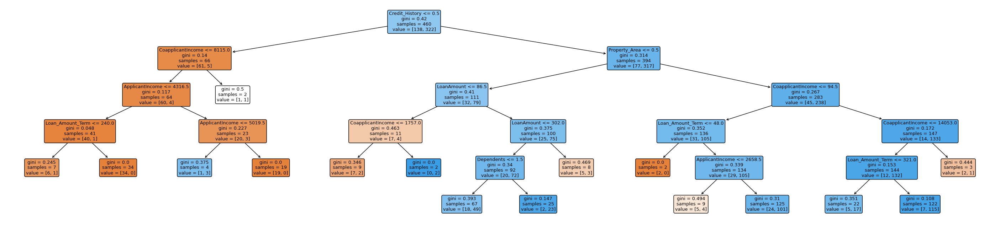

In [41]:
import matplotlib.pyplot as plt
#we will define the figure size for a better view
plt.figure(figsize=(36,8))
plot_tree(model,feature_names=x.columns,filled=True,
          rounded=True)
#plt.show()
plt.savefig("Loan_tree.png")

In [42]:
x.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 614 entries, 0 to 613
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Gender             614 non-null    int32  
 1   Married            614 non-null    int32  
 2   Dependents         614 non-null    int32  
 3   Education          614 non-null    int32  
 4   Self_Employed      614 non-null    int32  
 5   ApplicantIncome    614 non-null    int64  
 6   CoapplicantIncome  614 non-null    float64
 7   LoanAmount         614 non-null    float64
 8   Loan_Amount_Term   614 non-null    float64
 9   Credit_History     614 non-null    int32  
 10  Property_Area      614 non-null    int32  
dtypes: float64(3), int32(7), int64(1)
memory usage: 36.1 KB


In [43]:
x.columns

Index(['Gender', 'Married', 'Dependents', 'Education', 'Self_Employed',
       'ApplicantIncome', 'CoapplicantIncome', 'LoanAmount',
       'Loan_Amount_Term', 'Credit_History', 'Property_Area'],
      dtype='object')

In [44]:
#check the model with input samoles
gender = int(input("Enter the Gender-->0/1"))
applicant_income=int(input("Enter income:"))
coapplicant_income=float(input("Enter the coapplicant_income:"))
loan_amount=float(input(""))
term = float(input(""))
credit_history=float(input(""))
property_area=int(input(""))
married=int(input(""))
dependent=int(input(""))
education=int(input(""))
self_employed=int(input(""))

KeyboardInterrupt: Interrupted by user

In [ ]:
import numpy as np
#pass the above values to create an array
user_input = np.array([[gender,applicant_income,coapplicant_income,loan_amount,term,
                        credit_history,property_area,married,dependent,education,self_employed]])
#user_input
prediction = model.predict(user_input)[0]
if prediction==1:
    print("Loan will be Approved")
else:
    print("Loan is Rejected")

In [45]:
from imblearn.over_sampling import SMOTE
oversampling=SMOTE() #generating synthetic data

In [46]:
data.columns

Index(['Gender', 'Married', 'Dependents', 'Education', 'Self_Employed',
       'ApplicantIncome', 'CoapplicantIncome', 'LoanAmount',
       'Loan_Amount_Term', 'Credit_History', 'Property_Area', 'Loan_Status'],
      dtype='object')

In [47]:
oversam_columns = ['Gender', 'Married', 'Dependents', 'Education', 'Self_Employed','Credit_History', 'Property_Area', 'Loan_Status']

In [48]:
for i in range(len(oversam_columns)):
    x=data.drop(oversam_columns[i],axis=1)
    y=data[oversam_columns[i]]
    x_oversample,y_oversample = oversampling.fit_resample(x,y)
    data = pd.concat([pd.DataFrame(x_oversample),pd.DataFrame(y_oversample)],axis=1)
    print(data.shape)
    print('------------------------------------------')

(1004, 12)
------------------------------------------
(1140, 12)
------------------------------------------
(3068, 12)
------------------------------------------
(5568, 12)
------------------------------------------
(10732, 12)
------------------------------------------
(15856, 12)
------------------------------------------
(23199, 12)
------------------------------------------
(31642, 12)
------------------------------------------


In [49]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31642 entries, 0 to 31641
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   ApplicantIncome    31642 non-null  int64  
 1   CoapplicantIncome  31642 non-null  float64
 2   LoanAmount         31642 non-null  float64
 3   Loan_Amount_Term   31642 non-null  float64
 4   Gender             31642 non-null  int32  
 5   Married            31642 non-null  int32  
 6   Dependents         31642 non-null  int32  
 7   Education          31642 non-null  int32  
 8   Self_Employed      31642 non-null  int32  
 9   Credit_History     31642 non-null  int32  
 10  Property_Area      31642 non-null  int32  
 11  Loan_Status        31642 non-null  int32  
dtypes: float64(3), int32(8), int64(1)
memory usage: 1.9 MB


In [50]:
import plotly.express as px

In [ ]:
px.box('marrita

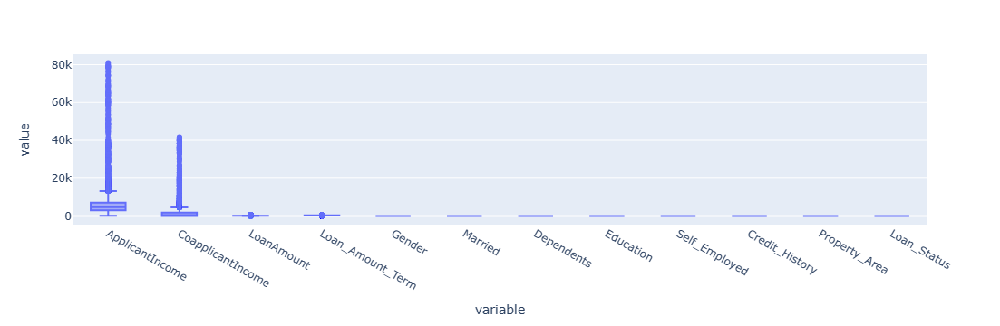

In [51]:
px.box(data)

In [61]:
def remove_outliers(data,col, threshold=1.5):
    Q1 = data[col].quantile(0.25)
    Q3 = data[col].quantile(0.75)

    IQR = Q3 - Q1

    lower_bound = Q1 - threshold * IQR
    upper_bound = Q3 + threshold * IQR

    data_no_outliers = data[(data[col] >=lower_bound) & (data[col] <= upper_bound)]
    percentage_outliers = ((len(data)-len(data_no_outliers))/len(data)*100)
        
    return data, percentage_outliers


In [62]:
x.columns

Index(['ApplicantIncome', 'CoapplicantIncome', 'LoanAmount',
       'Loan_Amount_Term', 'Gender', 'Married', 'Dependents', 'Education',
       'Self_Employed', 'Credit_History', 'Property_Area'],
      dtype='object')

In [63]:
cleaned_data,percentage_outliers=remove_outliers(data,'ApplicantIncome')
percentage_outliers

9.970924720308451

In [64]:
cleaned_data,percentage_outliers=remove_outliers(data,'CoapplicantIncome')
percentage_outliers

2.87276404778459

In [65]:
x=data.drop('Loan_Status',axis=1)
y=data['Loan_Status']

In [66]:
#divide the data into training and testing 
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.25,random_state=42)
                                    

In [67]:
#we will apply multiple models and choose the best one
#Logistic regression,decision tree ,random forest(Ensemble)
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

In [69]:
#start building the models,fit the data,check the metrics
#logistic Regression
log_model=LogisticRegression()
log_model.fit(x_train,y_train)
log_model_predictions= log_model.predict(x_test)
#Decision Tree Classifier
dtree=DecisionTreeClassifier()
dtree.fit(x_train,y_train)
dtree_pedictions=dtree.predict(x_test)
#RandomForestClassifier
rf_model=RandomForestClassifier()
rf_model.fit(x_train,y_train)
rf_model_predictions= rf_model.predict(x_test)

In [82]:
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score,confusion_matrix
#define a function for all the metrics
def evaluate_model(predictions,y_true):
    accuracy=accuracy_score(y_true,predictions)
    precision=precision_score(y_true,predictions)
    recall=recall_score(y_true,predictions)
    f1_scores=f1_score(y_true,predictions)
    c_mat=confusion_matrix(y_true,predictions)
    return accuracy,precision,recall,f1_scores,c_mat

In [85]:
#based on the above fu*n will check metrics for all 3 models
print("Logistic Regression Metrics:\n")
logistic_metrics=evaluate_model(log_model_predictions,y_test)
print(logistic_metrics)

print("Decision Tree Metrics:\n")
dtree_metrics=evaluate_model(dtree_pedictions,y_test)
print(dtree_metrics)
print("Random Forest Metrics:\n")
rf_metrics=evaluate_model(rf_model_predictions,y_test)
print(rf_metrics)


Logistic Regression Metrics:

(0.838326380988497, 0.7710327969036463, 0.9606598984771574, 0.8554638942253362, array([[2847, 1124],
       [ 155, 3785]], dtype=int64))
Decision Tree Metrics:

(0.9772468714448237, 0.973313192346425, 0.9812182741116752, 0.9772497472194136, array([[3865,  106],
       [  74, 3866]], dtype=int64))
Random Forest Metrics:

(0.9838199974718747, 0.9755489021956087, 0.9923857868020305, 0.9838953195772522, array([[3873,   98],
       [  30, 3910]], dtype=int64))


In [ ]:
data.info()

In [86]:
gender = int(input("Enter the Gender-->0/1"))
applicant_income=int(input("Enter income:"))
coapplicant_income=float(input("Enter the coapplicant_income:"))
loan_amount=float(input(""))
term = float(input(""))
credit_history=float(input(""))
property_area=int(input(""))
married=int(input(""))
dependent=int(input(""))
education=int(input(""))
self_employed=int(input(""))

Enter the Gender-->0/1 1
Enter income: 734643
Enter the coapplicant_income: 38743
 47833
 8893
 3498
 7675
 1
 1
 0
 1


In [87]:
#now will create the pickle file for our model and build the flask
#then will go for development(python anywhere)
import pickle

In [89]:
with open("Loan_Prediction.pkl",'wb')as f:
    pickle.dump(rf_model,f)

In [92]:
pip install flask

  Using cached click-8.1.7-py3-none-any.whl.metadata (3.0 kB)
  Using cached blinker-1.7.0-py3-none-any.whl.metadata (1.9 kB)
   ---------------------------------------- 0.0/99.7 kB ? eta -:--:--
   ------------ --------------------------- 30.7/99.7 kB 1.3 MB/s eta 0:00:01
   -------------------------------- ------- 81.9/99.7 kB 907.3 kB/s eta 0:00:01
   ---------------------------------------- 99.7/99.7 kB 952.0 kB/s eta 0:00:00
Using cached blinker-1.7.0-py3-none-any.whl (13 kB)
Using cached click-8.1.7-py3-none-any.whl (97 kB)
   ---------------------------------------- 0.0/226.7 kB ? eta -:--:--
   ------------------- -------------------- 112.6/226.7 kB 6.4 MB/s eta 0:00:01
   ---------------------------------------  225.3/226.7 kB 2.3 MB/s eta 0:00:01
   ---------------------------------------- 226.7/226.7 kB 2.3 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.
